### Get lagged data

According to the *Interim Estimates of Vaccine Effectiveness of BNT162b2 and mRNA-1273 COVID-19 Vaccines in Preventing SARS-CoV-2 Infection Among Health Care Personnel, First Responders, and Other Essential and Frontline Workers — Eight U.S. Locations, December 2020–March 2021* published by CDC, the effectiveness of vaccines has around 14 days lag. Thus, we will add two column **vaccine lag-7** and **vaccine lag-14** for our analysis.

In [3]:
! pip3 install shap

In [132]:
import pandas as pd
from sklearn.preprocessing import RobustScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score
import statsmodels.api as sm
from sklearn import svm
from sklearn.ensemble import RandomForestRegressor
from sklearn.datasets import make_regression
from sklearn.model_selection import RandomizedSearchCV
from sklearn.svm import SVR
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
import shap
import numpy as np
from sklearn.decomposition import PCA
from sklearn.linear_model import LinearRegression
from sklearn import tree
from sklearn.model_selection import GridSearchCV
import seaborn as sn

In [197]:
data = pd.read_csv("data.csv")

In [198]:
data.columns

Index(['Unnamed: 0', 'state', 'date',
       'retail_and_recreation_percent_change_from_baseline',
       'grocery_and_pharmacy_percent_change_from_baseline',
       'parks_percent_change_from_baseline',
       'transit_stations_percent_change_from_baseline',
       'workplaces_percent_change_from_baseline',
       'residential_percent_change_from_baseline', 'stay_at_home',
       'mask_mandate', 'business_open', 'people_fully_vaccinated_per_hundred',
       'daily_vaccinations_per_million', 'submission_date', 'state_abbr',
       'new_case', 'new_case_ma7', 'new_death', 'new_death_ma7',
       'population_density', 'population', 'new_death_growth_rate',
       'new_case_growth_rate', 'new_death_growth_rate_weekly',
       'new_case_growth_rate_weekly', 'new_death_pct', 'new_case_pct'],
      dtype='object')

In [199]:
min(data["date"])

'2021-01-01'

In [200]:
max(data["date"])

'2021-04-20'

In [201]:
data = data.replace("no value", None)

In [202]:
data["retail_and_recreation_percent_change_from_baseline"] = data["retail_and_recreation_percent_change_from_baseline"] / 100
data["grocery_and_pharmacy_percent_change_from_baseline"] = data["grocery_and_pharmacy_percent_change_from_baseline"] / 100
data["parks_percent_change_from_baseline"] = data["parks_percent_change_from_baseline"].astype(float) / 100
data["transit_stations_percent_change_from_baseline"] = data["transit_stations_percent_change_from_baseline"] / 100
data["workplaces_percent_change_from_baseline"] = data["workplaces_percent_change_from_baseline"] / 100
data["residential_percent_change_from_baseline"] = data["residential_percent_change_from_baseline"] / 100

In [203]:
new_data = pd.DataFrame()
for state in data["state"].unique():
    s = data[data["state"] == state]
    s["people_fully_vaccinated_per_hundred_lag7"] = s["people_fully_vaccinated_per_hundred"].shift(7)
    s["people_fully_vaccinated_per_hundred_lag14"] = s["people_fully_vaccinated_per_hundred"].shift(14)
    s["daily_vaccinations_per_million_lag7"] = s["daily_vaccinations_per_million"].shift(7)
    s["daily_vaccinations_per_million_lag14"] = s["daily_vaccinations_per_million"].shift(14)
    s["retail_and_recreation_percent_change_lag7"] = s["retail_and_recreation_percent_change_from_baseline"].shift(7)
    s["grocery_and_pharmacy_percent_change_lag7"] = s["grocery_and_pharmacy_percent_change_from_baseline"].shift(7)
    s["parks_percent_change_lag7"] = s["parks_percent_change_from_baseline"].shift(7)
    s["transit_stations_percent_change_lag7"] = s["transit_stations_percent_change_from_baseline"].shift(7)
    s["workplaces_percent_change_lag7"] = s["workplaces_percent_change_from_baseline"].shift(7)
    s["residential_percent_change_lag7"] = s["residential_percent_change_from_baseline"].shift(7)
    s["retail_and_recreation_percent_change_lag14"] = s["retail_and_recreation_percent_change_from_baseline"].shift(14)
    s["grocery_and_pharmacy_percent_change_lag14"] = s["grocery_and_pharmacy_percent_change_from_baseline"].shift(14)
    s["parks_percent_change_lag14"] = s["parks_percent_change_from_baseline"].shift(14)
    s["transit_stations_percent_change_lag14"] = s["transit_stations_percent_change_from_baseline"].shift(14)
    s["workplaces_percent_change_lag14"] = s["workplaces_percent_change_from_baseline"].shift(14)
    s["residential_percent_change_lag14"] = s["residential_percent_change_from_baseline"].shift(14)
    new_data = new_data.append(s)


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/

In [204]:
new_data = new_data[pd.to_datetime(new_data["date"]) > pd.to_datetime("01/01/2021")]

In [205]:
new_data.describe()

,Unnamed: 0,retail_and_recreation_percent_change_from_baseline,grocery_and_pharmacy_percent_change_from_baseline,parks_percent_change_from_baseline,transit_stations_percent_change_from_baseline,workplaces_percent_change_from_baseline,residential_percent_change_from_baseline,stay_at_home,mask_mandate,business_open,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,new_case,new_case_ma7,new_death,new_death_ma7,population_density,population,new_death_growth_rate,new_case_growth_rate,new_death_growth_rate_weekly,new_case_growth_rate_weekly,new_death_pct,new_case_pct,people_fully_vaccinated_per_hundred_lag7,people_fully_vaccinated_per_hundred_lag14,daily_vaccinations_per_million_lag7,daily_vaccinations_per_million_lag14,retail_and_recreation_percent_change_lag7,grocery_and_pharmacy_percent_change_lag7,parks_percent_change_lag7,transit_stations_percent_change_lag7,workplaces_percent_change_lag7,residential_percent_change_lag7,retail_and_recreation_percent_change_lag14,grocery_and_pharmacy_percent_change_lag14,parks_percent_change_lag14,transit_stations_percent_change_lag14,workplaces_percent_change_lag14,residential_percent_change_lag14
count,5559.000000,5559.000000,5559.000000,5559.000000,5559.000000,5559.000000,5559.000000,5559.000000,5559.000000,5559.000000,4689.000000,4900.000000,5559.000000,5559.000000,5559.000000,5559.000000,5559.000000,5.559000e+03,5559.000000,5559.000000,5553.000000,5553.000000,5559.000000,5559.000000,4339.000000,3989.000000,4550.000000,4200.000000,5253.000000,5253.000000,5253.000000,5253.000000,5253.000000,5253.000000,4896.000000,4896.000000,4896.000000,4896.000000,4896.000000,4896.000000
mean,2805.000000,-0.156008,-0.068550,0.050149,-0.243828,-0.251599,0.083562,0.019608,0.693110,0.348804,10.382367,6185.196531,1951.444325,2028.817336,35.411405,36.674607,86.043562,6.436069e+06,inf,-0.007675,inf,0.673917,0.000005,0.000292,9.164796,8.043144,5944.702857,5674.056429,-0.165513,-0.075490,0.024649,-0.254146,-0.258011,0.087175,-0.174295,-0.080758,-0.003150,-0.263246,-0.259990,0.089563
std,1619.607526,0.133389,0.094471,0.381044,0.197465,0.114062,0.046567,0.138661,0.461245,0.496963,8.070154,2656.687317,3612.077418,3545.809978,69.118568,62.011642,331.939366,7.288795e+06,NaN,0.071816,NaN,8.368305,0.000004,0.000214,7.033739,6.104959,2500.782601,2314.736772,0.135472,0.098037,0.362647,0.197182,0.123942,0.049649,0.133477,0.097713,0.344182,0.193751,0.125341,0.049718
min,1.000000,-0.790000,-0.660000,-0.760000,-0.840000,-0.860000,-0.040000,0.000000,0.000000,0.000000,0.000000,0.000000,-9549.000000,38.571429,-174.000000,-18.000000,0.081129,5.787590e+05,-4.571429,-0.559012,-35.000000,-0.914743,-0.000006,0.000027,0.000000,0.000000,0.000000,0.000000,-0.790000,-0.660000,-0.760000,-0.870000,-0.860000,-0.040000,-0.790000,-0.660000,-0.760000,-0.870000,-0.860000,-0.040000
25%,1402.500000,-0.230000,-0.120000,-0.210000,-0.390000,-0.320000,0.050000,0.000000,0.000000,0.000000,2.980000,4066.750000,279.000000,327.500000,2.000000,5.000000,8.705079,1.787065e+06,-0.057692,-0.038969,-0.255365,-0.199413,0.000002,0.000144,2.655000,2.380000,3940.000000,3806.000000,-0.240000,-0.130000,-0.220000,-0.400000,-0.330000,0.050000,-0.250000,-0.130000,-0.230000,-0.400000,-0.330000,0.060000
50%,2805.000000,-0.150000,-0.070000,-0.040000,-0.240000,-0.250000,0.080000,0.000000,1.000000,0.000000,8.930000,6016.000000,817.000000,919.000000,11.000000,15.142857,20.849967,4.467673e+06,0.000000,-0.010080,-0.090909,-0.074816,0.000004,0.000212,8.100000,7.070000,5816.000000,5523.000000,-0.160000,-0.070000,-0.050000,-0.250000,-0.250000,0.080000,-0.170000,-0.080000,-0.070000,-0.270000,-0.250000,0.080000
75%,4207.500000,-0.070000,-0.010000,0.220000,-0.110000,-0.170000,0.110000,0.000000,1.000000,1.000000,16.180000,7914.500000,2257.500000,2420.928571,39.000000,41.428571,49.720279,7.614893e+06,0.032258,0.018295,0.142857,0.089735,0.000007,0.000381,14.425000,12.800000,7631.500000,7318.250000,-0.080000,-0.020000,0.190000,-0.120000,-0.170000,0.110000,-0.090000,-0.0200

In [144]:
import matplotlib.pyplot as plt

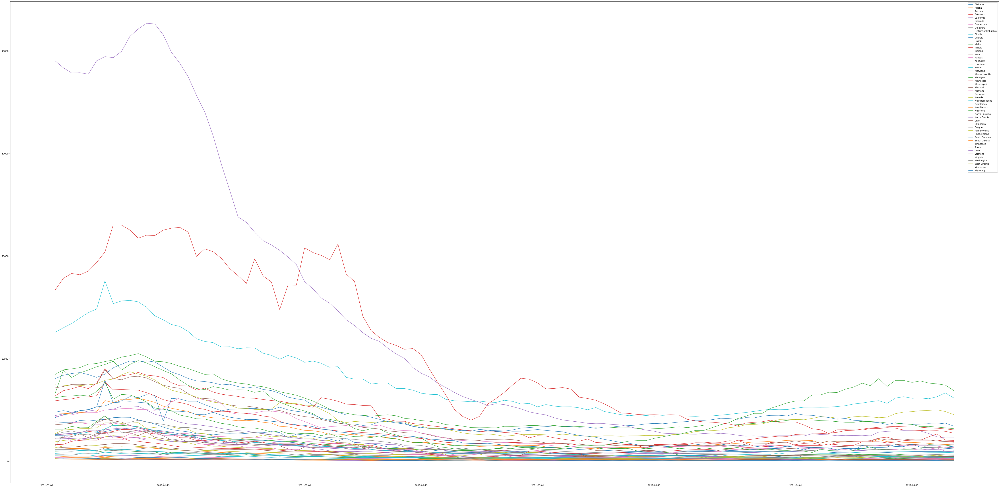

In [145]:
fig= plt.figure(figsize=(80,40))

for state in new_data["state"].unique():
    sub = new_data[new_data["state"] == state]

    x = pd.to_datetime(sub["date"])
    y = sub["new_case_ma7"]

    plt.plot(x, y, label = state)

plt.legend()

plt.show()

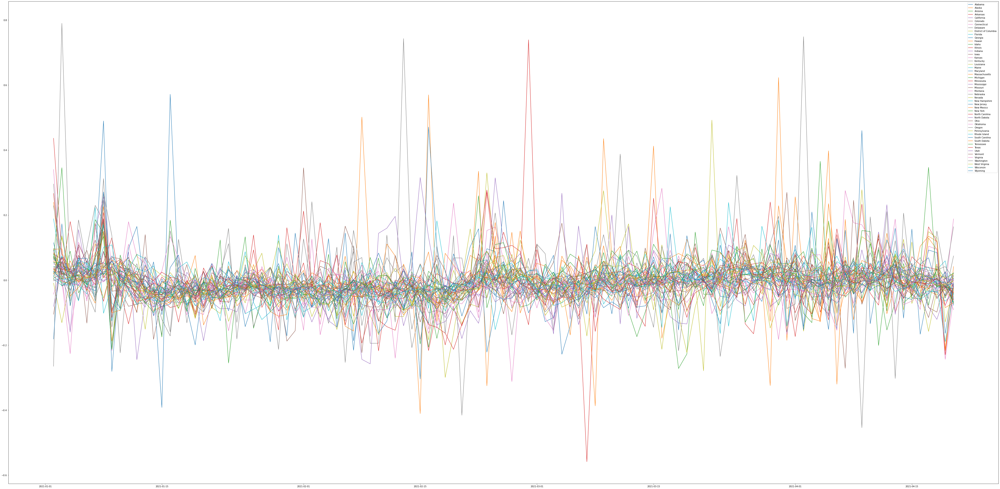

In [146]:
fig= plt.figure(figsize=(80,40))

for state in new_data["state"].unique():
    sub = new_data[new_data["state"] == state]

    x = pd.to_datetime(sub["date"])
    y = sub["new_case_growth_rate"]

    plt.plot(x, y, label = state)

plt.legend()

plt.show()

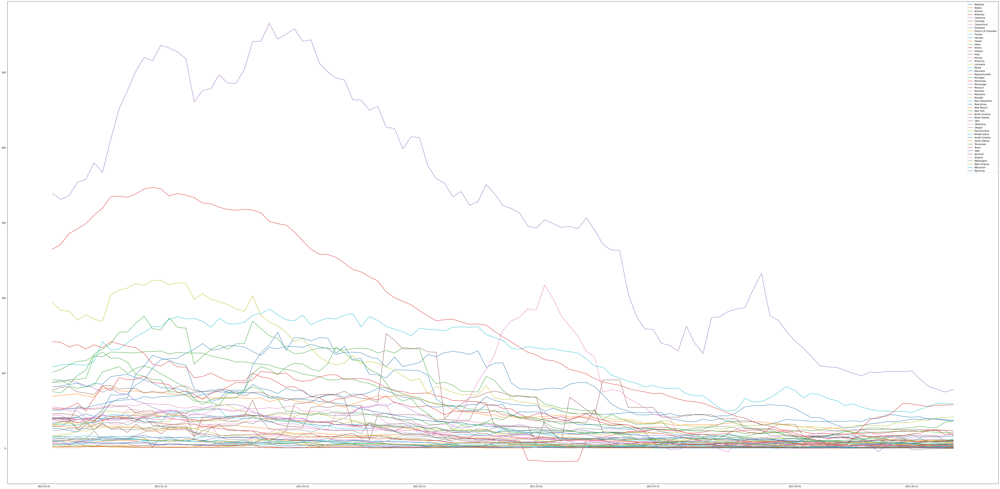

In [147]:
fig= plt.figure(figsize=(80,40))

for state in new_data["state"].unique():
    sub = new_data[new_data["state"] == state]

    x = pd.to_datetime(sub["date"])
    y = sub["new_death_ma7"]

    plt.plot(x, y, label = state)

plt.legend()

plt.show()

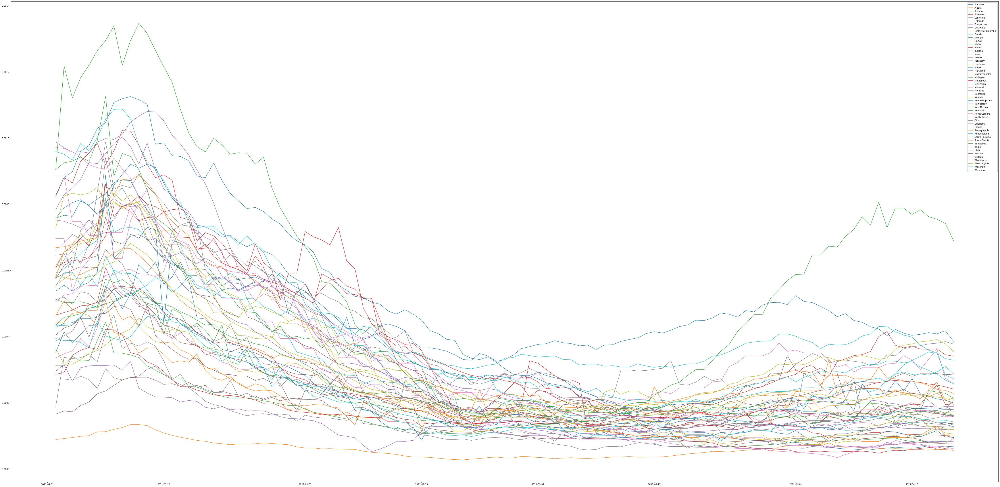

In [166]:
fig= plt.figure(figsize=(80,40))

for state in new_data["state"].unique():
    sub = new_data[new_data["state"] == state]

    x = pd.to_datetime(sub["date"])
    y = sub["new_case_pct"]

    plt.plot(x, y, label = state)

plt.legend()

plt.show()

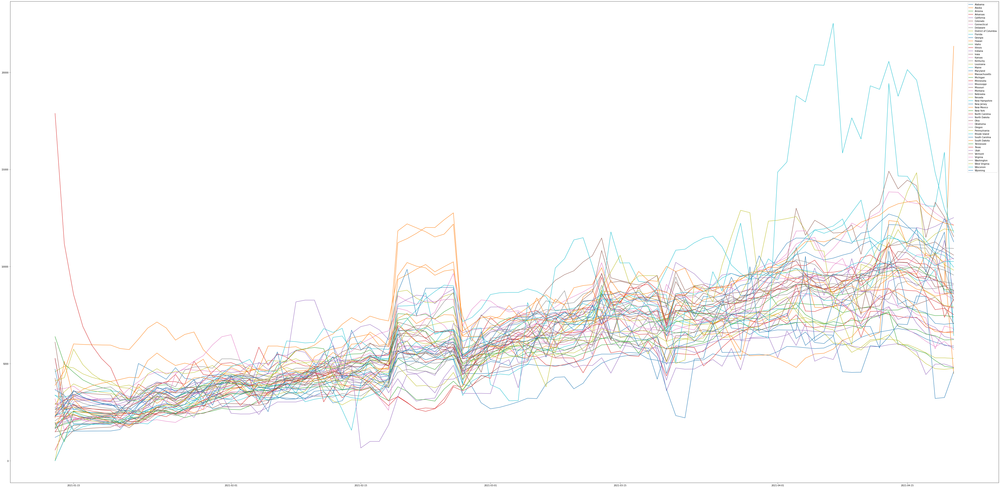

In [148]:
fig= plt.figure(figsize=(80,40))

for state in new_data["state"].unique():
    sub = new_data[new_data["state"] == state]

    x = pd.to_datetime(sub["date"])
    y = sub["daily_vaccinations_per_million"]

    plt.plot(x, y, label = state)

plt.legend()

plt.show()

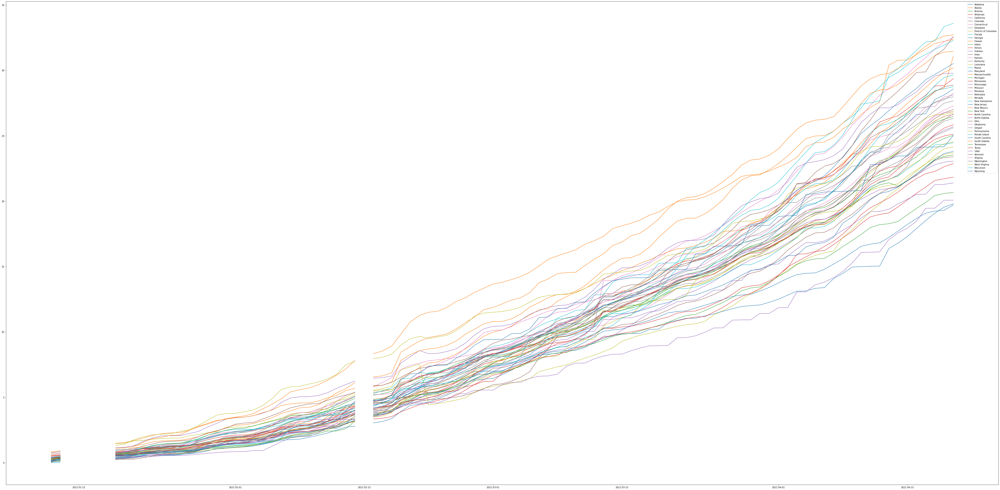

In [149]:
fig= plt.figure(figsize=(80,40))

for state in new_data["state"].unique():
    sub = new_data[new_data["state"] == state]

    x = pd.to_datetime(sub["date"])
    y = sub["people_fully_vaccinated_per_hundred"]

    plt.plot(x, y, label = state)

plt.legend()

plt.show()

In [206]:
len(new_data)

5559

In [207]:
data_without_na = new_data.dropna()

In [208]:
data_without_na.columns

Index(['Unnamed: 0', 'state', 'date',
       'retail_and_recreation_percent_change_from_baseline',
       'grocery_and_pharmacy_percent_change_from_baseline',
       'parks_percent_change_from_baseline',
       'transit_stations_percent_change_from_baseline',
       'workplaces_percent_change_from_baseline',
       'residential_percent_change_from_baseline', 'stay_at_home',
       'mask_mandate', 'business_open', 'people_fully_vaccinated_per_hundred',
       'daily_vaccinations_per_million', 'submission_date', 'state_abbr',
       'new_case', 'new_case_ma7', 'new_death', 'new_death_ma7',
       'population_density', 'population', 'new_death_growth_rate',
       'new_case_growth_rate', 'new_death_growth_rate_weekly',
       'new_case_growth_rate_weekly', 'new_death_pct', 'new_case_pct',
       'people_fully_vaccinated_per_hundred_lag7',
       'people_fully_vaccinated_per_hundred_lag14',
       'daily_vaccinations_per_million_lag7',
       'daily_vaccinations_per_million_lag14',
       

### Policy and mobility

In [153]:
mob = ['retail_and_recreation_percent_change_from_baseline',
       'grocery_and_pharmacy_percent_change_from_baseline',
       'parks_percent_change_from_baseline',
       'transit_stations_percent_change_from_baseline',
       'workplaces_percent_change_from_baseline',
       'residential_percent_change_from_baseline']
pol = ['stay_at_home',
       'mask_mandate', 'business_open']

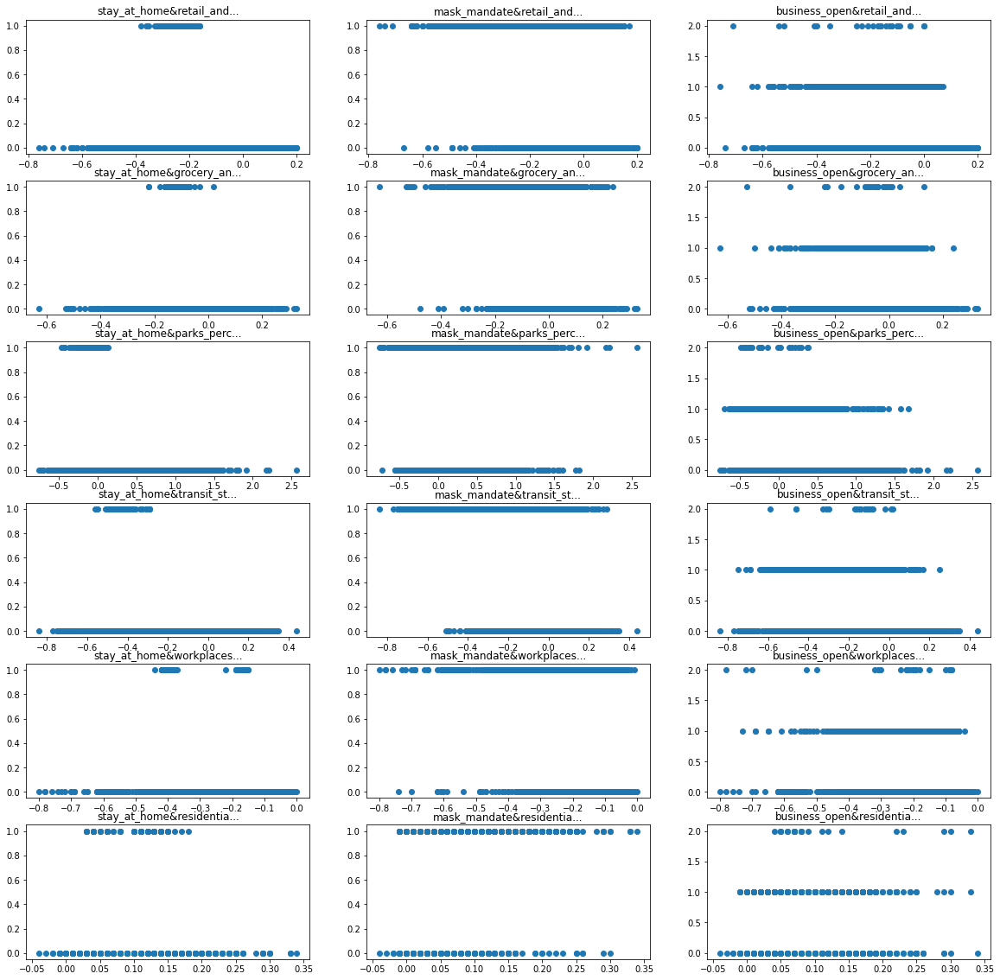

In [154]:
fig = plt.figure(figsize=(20, 20))
axs = fig.subplots(len(mob), len(pol))
for i in range(0, len(pol)):
    for j in range(0, len(mob)):
        axs[j, i].scatter(data_without_na[mob[j]], data_without_na[pol[i]])
        axs[j, i].set_title(pol[i]+"&"+mob[j][:10]+"...")

plt.show()

### Correlation matrix

In [155]:
columns = ['retail_and_recreation_percent_change_from_baseline',
       'grocery_and_pharmacy_percent_change_from_baseline',
       'parks_percent_change_from_baseline',
       'transit_stations_percent_change_from_baseline',
       'workplaces_percent_change_from_baseline',
       'residential_percent_change_from_baseline']

In [156]:
X = data_without_na[columns]

In [157]:
X.corr()

,retail_and_recreation_percent_change_from_baseline,grocery_and_pharmacy_percent_change_from_baseline,parks_percent_change_from_baseline,transit_stations_percent_change_from_baseline,workplaces_percent_change_from_baseline,residential_percent_change_from_baseline
retail_and_recreation_percent_change_from_baseline,1.000000,0.868974,0.617132,0.808386,0.524715,-0.723859
grocery_and_pharmacy_percent_change_from_baseline,0.868974,1.000000,0.596800,0.713260,0.500764,-0.681891
parks_percent_change_from_baseline,0.617132,0.596800,1.000000,0.486756,0.325315,-0.574889
transit_stations_percent_change_from_baseline,0.808386,0.713260,0.486756,1.000000,0.603781,-0.746291
workplaces_percent_change_from_baseline,0.524715,0.500764,0.325315,0.603781,1.000000,-0.858674
residential_percent_change_from_baseline,-0.723859,-0.681891,-0.574889,-0.746291,-0.858674,1.000000


In [158]:
corr = X.corr()

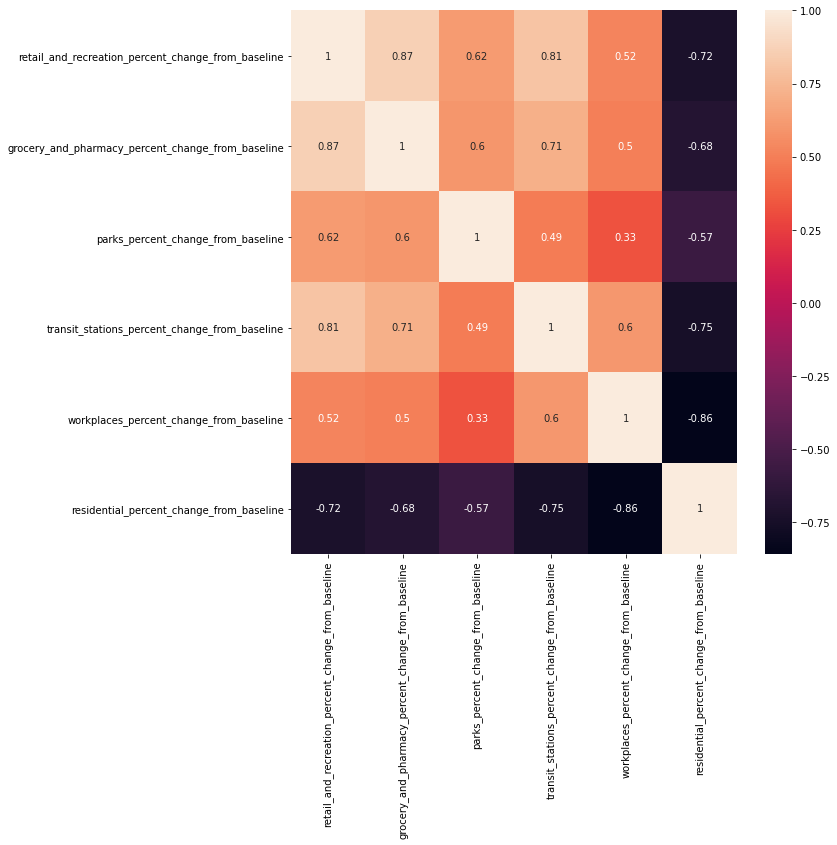

In [159]:
fig= plt.figure(figsize=(10,10))

sn.heatmap(corr, annot=True)
plt.show()

In [160]:
for i in range(corr.shape[0]):
    for j in range(i+1, corr.shape[0]):
        if abs(corr.iloc[i,j]) >= 0.85:
            print(i, j, columns[i], columns[j], corr.iloc[i,j])

0 1 retail_and_recreation_percent_change_from_baseline grocery_and_pharmacy_percent_change_from_baseline 0.8689741130830179
4 5 workplaces_percent_change_from_baseline residential_percent_change_from_baseline -0.8586742050134736


### Mobility feature selection

In [167]:
Y2 = data_without_na["new_case_pct"]

In [209]:
columns = [
       'retail_and_recreation_percent_change_lag7',
       'grocery_and_pharmacy_percent_change_lag7', 'parks_percent_change_lag7',
       'transit_stations_percent_change_lag7',
       'workplaces_percent_change_lag7', 'residential_percent_change_lag7',
       'retail_and_recreation_percent_change_lag14',
       'grocery_and_pharmacy_percent_change_lag14',
       'parks_percent_change_lag14', 'transit_stations_percent_change_lag14',
       'workplaces_percent_change_lag14', 'residential_percent_change_lag14'
       ]
features = len(columns)
c = columns.copy()

In [210]:
X = data_without_na[c]
scaler = RobustScaler() 
X_scaled = scaler.fit_transform(X)

In [211]:
regressor_OLS = sm.OLS(Y2, X_scaled).fit()
for i in range(len(columns)):
    print(columns[i], regressor_OLS.pvalues[i])

retail_and_recreation_percent_change_lag7 5.331675446847024e-06
grocery_and_pharmacy_percent_change_lag7 0.15834928819210314
parks_percent_change_lag7 8.581762035746656e-60
transit_stations_percent_change_lag7 1.266568728805843e-54
workplaces_percent_change_lag7 5.675366180155229e-36
residential_percent_change_lag7 1.799766210874688e-127
retail_and_recreation_percent_change_lag14 0.022966282173108695
grocery_and_pharmacy_percent_change_lag14 0.11074951227833282
parks_percent_change_lag14 1.1487377604745538e-14
transit_stations_percent_change_lag14 5.616382064223976e-43
workplaces_percent_change_lag14 0.9511401050358271
residential_percent_change_lag14 8.899385356118842e-07


In [212]:
for i in range(0, features):
    X = data_without_na[c]
    scaler = RobustScaler() 
    X_scaled = scaler.fit_transform(X)
    regressor_OLS = sm.OLS(Y2, X_scaled).fit()
    maxVar = max(regressor_OLS.pvalues)
    if maxVar > 0.05:
        for j in range(0, features - i):
            if (regressor_OLS.pvalues[j].astype(float) == maxVar):
                print(maxVar, c[j])
                c = np.delete(c, j)
    if maxVar <= 0.05:
        break
                
print(regressor_OLS.summary())
for i in range(len(c)):
    print(c[i], regressor_OLS.pvalues[i])


0.9511401050358271 workplaces_percent_change_lag14
0.1507179391094626 grocery_and_pharmacy_percent_change_lag7
                                 OLS Regression Results                                
Dep. Variable:           new_case_pct   R-squared (uncentered):                   0.360
Model:                            OLS   Adj. R-squared (uncentered):              0.359
Method:                 Least Squares   F-statistic:                              215.9
Date:                Tue, 27 Apr 2021   Prob (F-statistic):                        0.00
Time:                        05:23:00   Log-Likelihood:                          27572.
No. Observations:                3845   AIC:                                 -5.512e+04
Df Residuals:                    3835   BIC:                                 -5.506e+04
Df Model:                          10                                                  
Covariance Type:            nonrobust                                                  
         

In [227]:
selected_mob_column = ['retail_and_recreation_percent_change_lag7',
                       'parks_percent_change_lag7',
       'transit_stations_percent_change_lag7',
       'residential_percent_change_lag7']

In [214]:
new_data = pd.concat([new_data, pd.get_dummies(new_data["business_open"], prefix="business_open")], axis=1)
new_data.columns

Index(['Unnamed: 0', 'state', 'date',
       'retail_and_recreation_percent_change_from_baseline',
       'grocery_and_pharmacy_percent_change_from_baseline',
       'parks_percent_change_from_baseline',
       'transit_stations_percent_change_from_baseline',
       'workplaces_percent_change_from_baseline',
       'residential_percent_change_from_baseline', 'stay_at_home',
       'mask_mandate', 'business_open', 'people_fully_vaccinated_per_hundred',
       'daily_vaccinations_per_million', 'submission_date', 'state_abbr',
       'new_case', 'new_case_ma7', 'new_death', 'new_death_ma7',
       'population_density', 'population', 'new_death_growth_rate',
       'new_case_growth_rate', 'new_death_growth_rate_weekly',
       'new_case_growth_rate_weekly', 'new_death_pct', 'new_case_pct',
       'people_fully_vaccinated_per_hundred_lag7',
       'people_fully_vaccinated_per_hundred_lag14',
       'daily_vaccinations_per_million_lag7',
       'daily_vaccinations_per_million_lag14',
       

### Vaccine feature selection

In [215]:
columns = ['people_fully_vaccinated_per_hundred',
       'daily_vaccinations_per_million',
        'people_fully_vaccinated_per_hundred_lag7',
       'people_fully_vaccinated_per_hundred_lag14',
       'daily_vaccinations_per_million_lag7',
       'daily_vaccinations_per_million_lag14']
features = len(columns)
c = columns.copy()

In [216]:
X = data_without_na[c]
scaler = RobustScaler() 
X_scaled = scaler.fit_transform(X)

In [217]:
regressor_OLS = sm.OLS(Y2, X_scaled).fit()
for i in range(len(columns)):
    print(columns[i], regressor_OLS.pvalues[i])

people_fully_vaccinated_per_hundred 0.04511669012195262
daily_vaccinations_per_million 0.2619335922437291
people_fully_vaccinated_per_hundred_lag7 1.3031571237737767e-19
people_fully_vaccinated_per_hundred_lag14 4.307593803740342e-42
daily_vaccinations_per_million_lag7 6.023942372334609e-06
daily_vaccinations_per_million_lag14 2.9905762665095425e-08


In [218]:
for i in range(0, features):
    X = data_without_na[c]
    scaler = RobustScaler() 
    X_scaled = scaler.fit_transform(X)
    regressor_OLS = sm.OLS(Y2, X_scaled).fit()
    maxVar = max(regressor_OLS.pvalues)
    if maxVar > 0.05:
        for j in range(0, features - i):
            if (regressor_OLS.pvalues[j].astype(float) == maxVar):
                print(maxVar, c[j])
                c = np.delete(c, j)
    if maxVar <= 0.05:
        break
                
print(regressor_OLS.summary())
for i in range(len(c)):
    print(c[i], regressor_OLS.pvalues[i])

0.2619335922437291 daily_vaccinations_per_million
                                 OLS Regression Results                                
Dep. Variable:           new_case_pct   R-squared (uncentered):                   0.063
Model:                            OLS   Adj. R-squared (uncentered):              0.061
Method:                 Least Squares   F-statistic:                              51.26
Date:                Tue, 27 Apr 2021   Prob (F-statistic):                    1.33e-51
Time:                        05:25:08   Log-Likelihood:                          26838.
No. Observations:                3845   AIC:                                 -5.367e+04
Df Residuals:                    3840   BIC:                                 -5.364e+04
Df Model:                           5                                                  
Covariance Type:            nonrobust                                                  
                 coef    std err          t      P>|t|      [0.025    

In [219]:
from sklearn.preprocessing import PolynomialFeatures

In [220]:
poly = PolynomialFeatures(degree = 3)
c = columns.copy()

In [221]:
for v in c:
    X = data_without_na[[v]]
    scaler = RobustScaler() 
    X_scaled = scaler.fit_transform(X)
    X_poly = poly.fit_transform(X_scaled)
    regressor_OLS = sm.OLS(Y2, X_poly).fit()
    print(v)
    print(regressor_OLS.summary())

people_fully_vaccinated_per_hundred
                            OLS Regression Results                            
Dep. Variable:           new_case_pct   R-squared:                       0.288
Model:                            OLS   Adj. R-squared:                  0.288
Method:                 Least Squares   F-statistic:                     518.1
Date:                Tue, 27 Apr 2021   Prob (F-statistic):          1.01e-282
Time:                        05:25:27   Log-Likelihood:                 30077.
No. Observations:                3845   AIC:                        -6.015e+04
Df Residuals:                    3841   BIC:                        -6.012e+04
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          0

In [222]:
select_vac_column = ["people_fully_vaccinated_per_hundred_lag14"]

## General analysis

In [223]:
scaler = RobustScaler() 

In [228]:
c = select_vac_column + selected_mob_column + pol + ["population_density"]

In [229]:
c

['people_fully_vaccinated_per_hundred_lag14',
 'retail_and_recreation_percent_change_lag7',
 'parks_percent_change_lag7',
 'transit_stations_percent_change_lag7',
 'residential_percent_change_lag7',
 'stay_at_home',
 'mask_mandate',
 'business_open',
 'population_density']

In [230]:
X = data_without_na[c]
X_scaled = scaler.fit_transform(X)
X_scaled_df = pd.DataFrame(X_scaled, columns = X.columns)
X_train, X_test, y_train, y_test = train_test_split(X_scaled_df, Y2, test_size=0.2, random_state=42)

In [231]:
model = LinearRegression().fit(X_train, y_train)

In [232]:
y_pred = model.predict(X_test)
r2_score(y_test, y_pred)

0.13598663256080545

In [233]:
explainer = shap.LinearExplainer(model, X_train)
shap_values = explainer.shap_values(X_test)

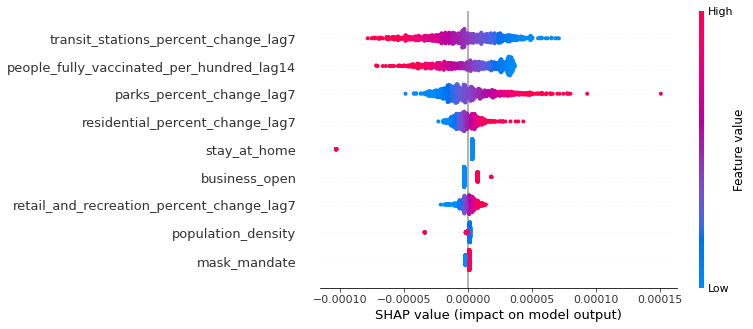

In [234]:
shap.summary_plot(shap_values, X_test)

### Desicion Tree

In [235]:
cols = c.copy()
X = data_without_na[cols]
X_train, X_test, y_train, y_test = train_test_split(X, Y2, test_size=0.2, random_state=42)

In [236]:
clf = tree.DecisionTreeRegressor(random_state=42)

In [237]:
grid = {'criterion': ["mse", "friedman_mse", "mae", "poisson"],
               'max_features': ['auto', 'sqrt'],
               'max_depth': range(2, 13),
               'min_samples_leaf': [1, 2, 4],}

In [238]:
clf_random = GridSearchCV(estimator = clf, param_grid = grid, cv = 3, n_jobs = -2)

In [240]:
clf_random.fit(X_train, y_train)

Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
KeyError: 'poisson'

Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
KeyError: 'poisson'

Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
KeyError: 'poisson'

Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
KeyError: 'poisson'

Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
KeyError: 'poisson'

Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
KeyError: 'poisson'

Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
KeyError: 'poisson'

Estimator fit failed. The score on this train-test partition for thes

GridSearchCV(cv=3, error_score=nan,
             estimator=DecisionTreeRegressor(ccp_alpha=0.0, criterion='mse',
                                             max_depth=None, max_features=None,
                                             max_leaf_nodes=None,
                                             min_impurity_decrease=0.0,
                                             min_impurity_split=None,
                                             min_samples_leaf=1,
                                             min_samples_split=2,
                                             min_weight_fraction_leaf=0.0,
                                             presort='deprecated',
                                             random_state=42, splitter='best'),
             iid='deprecated', n_jobs=-2,
             param_grid={'criterion': ['mse', 'friedman_mse', 'mae', 'poisson'],
                         'max_depth': range(2, 13),
                         'max_features': ['auto', 'sqrt'],
            

In [241]:
clf_random.best_estimator_

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mae', max_depth=11,
                      max_features='auto', max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=2, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=42, splitter='best')

In [242]:
best_model = clf_random.best_estimator_

In [243]:
best_model.fit(X_train, y_train)
y_pred = best_model.predict(X_test)
r2_score(y_test, y_pred)

0.7760448512094067

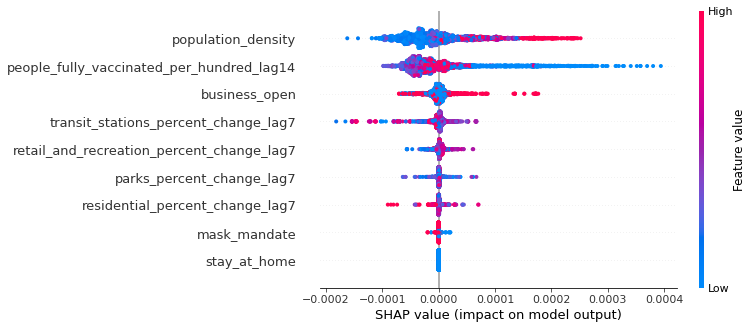

In [244]:
explainer = shap.TreeExplainer(best_model)
shap_values = explainer(X_train)
shap.plots.beeswarm(shap_values)

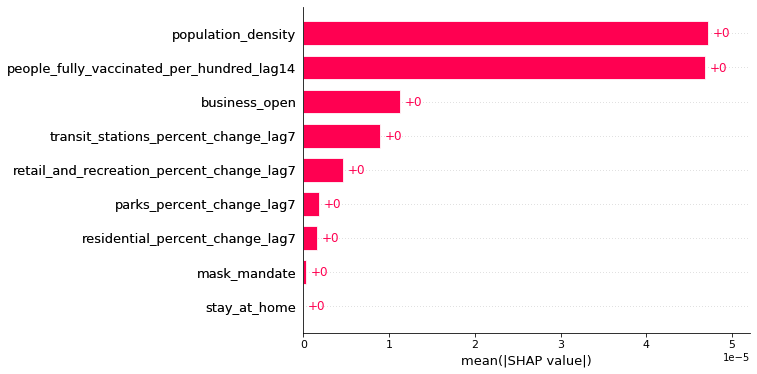

In [245]:
shap.plots.bar(shap_values)

### Random forest

In [246]:
X = data_without_na[c]
X_train, X_test, y_train, y_test = train_test_split(X, Y2, test_size=0.2, random_state=42)
rf = RandomForestRegressor()

In [247]:
grid = {'n_estimators': range(200, 2001, 200),
               'max_features': ['auto', 'sqrt'],
               'max_depth': range(2, 15, 2),
               'min_samples_leaf': [1, 2, 4],
            'bootstrap': [True, False]}

In [248]:
rf_random = RandomizedSearchCV(estimator = rf, param_distributions = grid, n_iter = 100, cv = 3, verbose=2, random_state=42, n_jobs = -2)

In [249]:
rf_random.fit(X_train, y_train)

Fitting 3 folds for each of 100 candidates, totalling 300 fits
[CV] n_estimators=1200, min_samples_leaf=1, max_features=sqrt, max_depth=10, bootstrap=False 


[Parallel(n_jobs=-2)]: Using backend SequentialBackend with 1 concurrent workers.


[CV]  n_estimators=1200, min_samples_leaf=1, max_features=sqrt, max_depth=10, bootstrap=False, total=   1.1s
[CV] n_estimators=1200, min_samples_leaf=1, max_features=sqrt, max_depth=10, bootstrap=False 


[Parallel(n_jobs=-2)]: Done   1 out of   1 | elapsed:    1.1s remaining:    0.0s


[CV]  n_estimators=1200, min_samples_leaf=1, max_features=sqrt, max_depth=10, bootstrap=False, total=   1.1s
[CV] n_estimators=1200, min_samples_leaf=1, max_features=sqrt, max_depth=10, bootstrap=False 
[CV]  n_estimators=1200, min_samples_leaf=1, max_features=sqrt, max_depth=10, bootstrap=False, total=   1.0s
[CV] n_estimators=1400, min_samples_leaf=1, max_features=sqrt, max_depth=14, bootstrap=False 
[CV]  n_estimators=1400, min_samples_leaf=1, max_features=sqrt, max_depth=14, bootstrap=False, total=   1.2s
[CV] n_estimators=1400, min_samples_leaf=1, max_features=sqrt, max_depth=14, bootstrap=False 
[CV]  n_estimators=1400, min_samples_leaf=1, max_features=sqrt, max_depth=14, bootstrap=False, total=   1.2s
[CV] n_estimators=1400, min_samples_leaf=1, max_features=sqrt, max_depth=14, bootstrap=False 
[CV]  n_estimators=1400, min_samples_leaf=1, max_features=sqrt, max_depth=14, bootstrap=False, total=   1.2s
[CV] n_estimators=200, min_samples_leaf=1, max_features=sqrt, max_depth=2, boot

[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:  6.3min finished


RandomizedSearchCV(cv=3, error_score=nan,
                   estimator=RandomForestRegressor(bootstrap=True,
                                                   ccp_alpha=0.0,
                                                   criterion='mse',
                                                   max_depth=None,
                                                   max_features='auto',
                                                   max_leaf_nodes=None,
                                                   max_samples=None,
                                                   min_impurity_decrease=0.0,
                                                   min_impurity_split=None,
                                                   min_samples_leaf=1,
                                                   min_samples_split=2,
                                                   min_weight_fraction_leaf=0.0,
                                                   n_estimators=100,
                              

In [250]:
rf_random.best_params_

{'bootstrap': True,
 'max_depth': 8,
 'max_features': 'sqrt',
 'min_samples_leaf': 1,
 'n_estimators': 400}

In [251]:
base_model = RandomForestRegressor(n_estimators = 10, random_state = 42)
base_model.fit(X_train, y_train)
y_pred = base_model.predict(X_test)
r2_score(y_test, y_pred)

-0.001957360735866054

In [252]:
model = rf_random.best_estimator_
model.fit(X_train, y_train)
y_pred = model.predict(X_test)
r2_score(y_test, y_pred)

-0.0017594541982841605

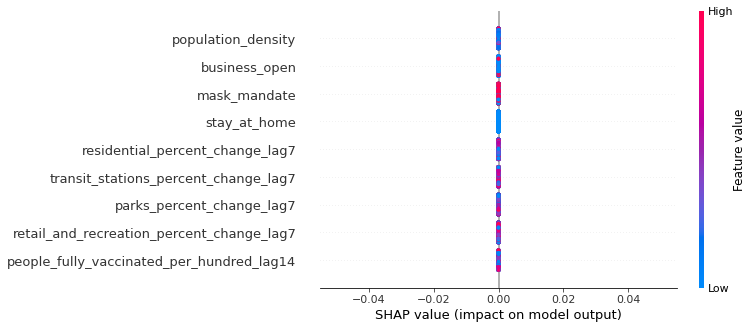

In [253]:
explainer = shap.TreeExplainer(model)
shap_values = explainer(X_train)
shap.plots.beeswarm(shap_values)

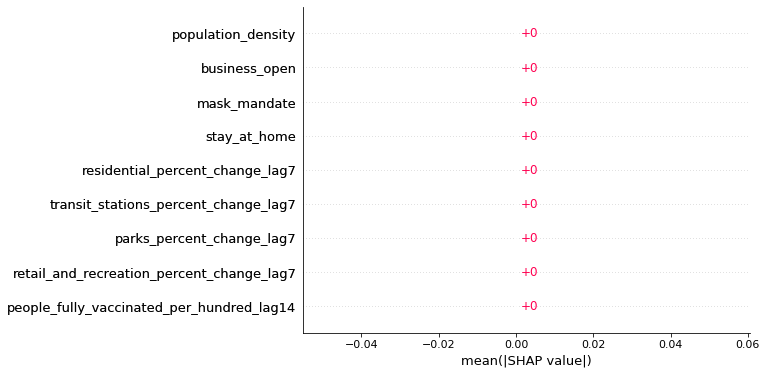

In [254]:
shap.plots.bar(shap_values)

### SVM

In [255]:
X = data_without_na[c]
X_train, X_test, y_train, y_test = train_test_split(X, Y2, test_size=0.2, random_state=42)

In [256]:
for k in ["linear", "poly", "rbf", "sigmoid"]:
    regr = make_pipeline(StandardScaler(), SVR(kernel=k, C=1.0))
    regr.fit(X_train, y_train)
    y_pred = regr.predict(X_test)
    print(k, r2_score(y_test, y_pred))

linear -6.6303789761513885
poly -6.6303789761513885
rbf -6.6303789761513885
sigmoid -6.6303789761513885


In [257]:
for k in ["linear", "poly", "rbf", "sigmoid"]:
    regr = make_pipeline(RobustScaler(), SVR(kernel=k, C=1.0, epsilon=0.0001))
    regr.fit(X_train, y_train)
    y_pred = regr.predict(X_test)
    print(k, r2_score(y_test, y_pred))

linear -6.630378976151578
poly -6.630378976151578
rbf -6.630378976151578
sigmoid -6.630378976151578


In [258]:
model = SVR(kernel="poly", C=1.0, epsilon=0.0001)
scaler = RobustScaler()
X = data_without_na[c]
X_scaled = scaler.fit_transform(X)
X_scaled_df = pd.DataFrame(X_scaled, columns = X.columns)
X_train, X_test, y_train, y_test = train_test_split(X_scaled_df, Y2, test_size=0.2, random_state=42)
model.fit(X_train, y_train)
y_pred = model.predict(X_test)
print(r2_score(y_test, y_pred))

-6.630378976151578


In [259]:
explainer = shap.KernelExplainer(model.predict, X_train[:50])
shap_values = explainer.shap_values(X_test[:50], nsamples=100)

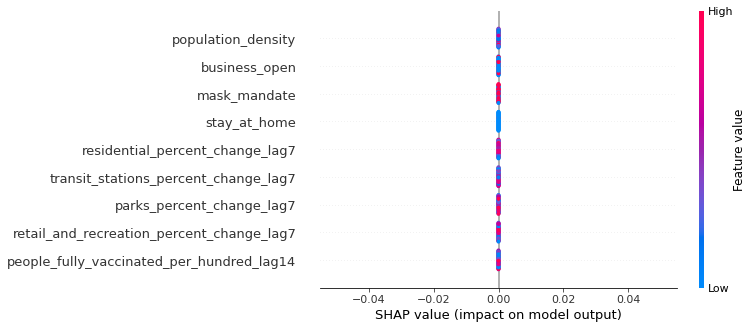

In [260]:
shap.summary_plot(shap_values, X_test[:50])

### KNN

In [261]:
from sklearn.neighbors import KNeighborsRegressor

In [262]:
X = data_without_na[c]
X_scaled = scaler.fit_transform(X)
X_scaled_df = pd.DataFrame(X_scaled, columns = X.columns)
X_train, X_test, y_train, y_test = train_test_split(X_scaled_df, Y2, test_size=0.2, random_state=42)

In [263]:
neigh = KNeighborsRegressor()

In [264]:
grid = {"n_neighbors": range(2, 30), "weights": ["uniform", "distance"]}
neigh_random = GridSearchCV(estimator = neigh, param_grid = grid, cv = 3, n_jobs = -2)

In [265]:
neigh_random.fit(X_train, y_train)

GridSearchCV(cv=3, error_score=nan,
             estimator=KNeighborsRegressor(algorithm='auto', leaf_size=30,
                                           metric='minkowski',
                                           metric_params=None, n_jobs=None,
                                           n_neighbors=5, p=2,
                                           weights='uniform'),
             iid='deprecated', n_jobs=-2,
             param_grid={'n_neighbors': range(2, 30),
                         'weights': ['uniform', 'distance']},
             pre_dispatch='2*n_jobs', refit=True, return_train_score=False,
             scoring=None, verbose=0)

In [266]:
neigh_random.best_estimator_

KNeighborsRegressor(algorithm='auto', leaf_size=30, metric='minkowski',
                    metric_params=None, n_jobs=None, n_neighbors=4, p=2,
                    weights='distance')

In [267]:
best_model = neigh_random.best_estimator_
model.fit(X_train, y_train)
y_pred = model.predict(X_test)
r2_score(y_test, y_pred)

-6.630378976151578

In [268]:
explainer = shap.KernelExplainer(best_model.predict, X_train[:100])
shap_values = explainer.shap_values(X_test[:100])

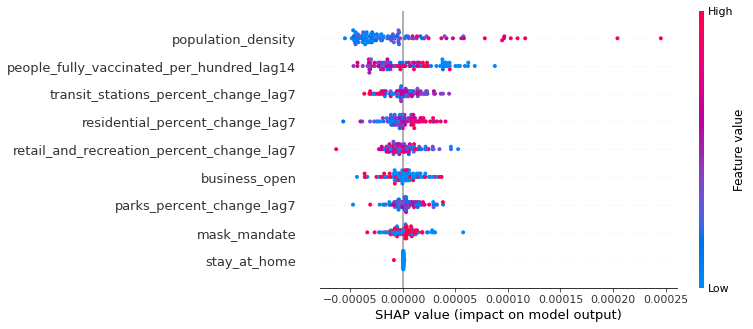

In [269]:
shap.summary_plot(shap_values, X_test[:100])

## Transform Y to categorical data

In [282]:
Y3 = Y2.copy()

In [283]:
Y2.mean()

0.00020210727662692217

In [284]:
from scipy import stats
k2, p = stats.normaltest(Y2)
p

1.2000161428564169e-264

In [285]:
Y3[Y3<Y2.mean()] = 0
Y3[Y3>Y2.mean()] = 1
Y3[Y3==0] = "below avg"
Y3[Y3==1] = "above avg"

### Logistic regression

In [272]:
from sklearn.linear_model import LogisticRegression

In [286]:
X = data_without_na[c]
X_scaled = scaler.fit_transform(X)
X_scaled_df = pd.DataFrame(X_scaled, columns = X.columns)
X_train, X_test, y_train, y_test = train_test_split(X_scaled_df, Y3, test_size=0.2, random_state=42)

In [288]:
clf = LogisticRegression(random_state=42).fit(X_train, y_train)

In [289]:
clf.score(X_test, y_test)

0.6332899869960988

In [290]:
explainer = shap.LinearExplainer(clf, X_train)
shap_values = explainer.shap_values(X_test)

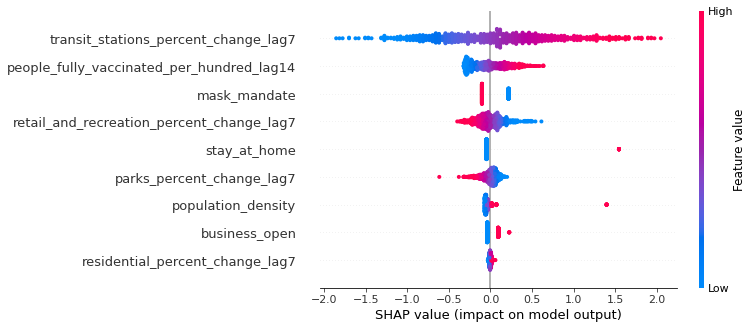

In [291]:
shap.summary_plot(shap_values, X_test)

### Decision Trees

In [292]:
from sklearn.tree import DecisionTreeClassifier

In [293]:
X = data_without_na[c]
X_train, X_test, y_train, y_test = train_test_split(X, Y3, test_size=0.2, random_state=42)

In [294]:
clf = DecisionTreeClassifier(random_state=42)

In [295]:
grid = {'max_features': ['auto', 'sqrt'],
               'max_depth': range(2, 13),
               'min_samples_leaf': [1, 2, 4],}

In [296]:
clf_random = GridSearchCV(estimator = clf, param_grid = grid, cv = 3, n_jobs = -2)
clf_random.fit(X_train, y_train)

GridSearchCV(cv=3, error_score=nan,
             estimator=DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None,
                                              criterion='gini', max_depth=None,
                                              max_features=None,
                                              max_leaf_nodes=None,
                                              min_impurity_decrease=0.0,
                                              min_impurity_split=None,
                                              min_samples_leaf=1,
                                              min_samples_split=2,
                                              min_weight_fraction_leaf=0.0,
                                              presort='deprecated',
                                              random_state=42,
                                              splitter='best'),
             iid='deprecated', n_jobs=-2,
             param_grid={'max_depth': range(2, 13),
                         'max_

In [297]:
clf_random.best_estimator_

DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='gini',
                       max_depth=12, max_features='auto', max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort='deprecated',
                       random_state=42, splitter='best')

In [324]:
best_model = DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='gini',
                       max_depth=12, max_features='auto', max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort='deprecated',
                       random_state=42, splitter='best')
best_model.fit(X_train, y_train)
best_model.score(X_test, y_test)

0.8634590377113134

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.858719 to fit



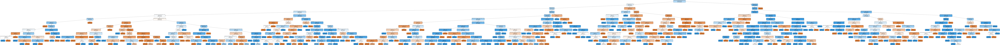

In [325]:
from IPython.display import Image  
import pydotplus
thestring = tree.export_graphviz(best_model, out_file=None,  
                         feature_names=X_train.columns.values, 
                         class_names=['above avg', 'below avg'],  
                         filled=True, rounded=True,  
                         special_characters=True,impurity=False)
graph = pydotplus.graph_from_dot_data(thestring)  
Image(graph.create_png())  

In [300]:
explainer = shap.TreeExplainer(best_model)
shap_values = explainer.shap_values(X)

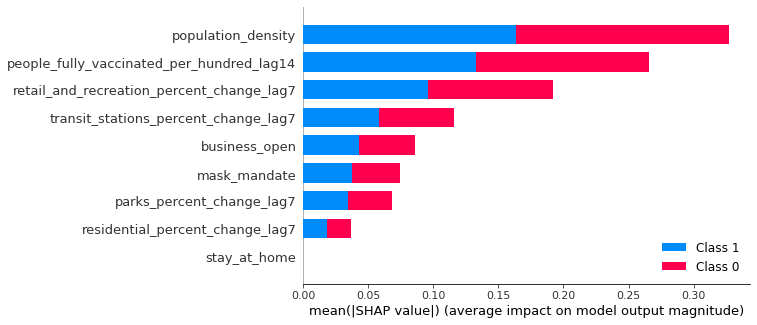

In [301]:
shap.summary_plot(shap_values, X)

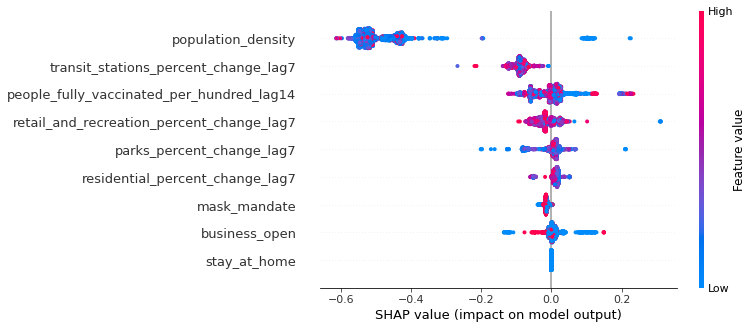

In [326]:
best_model = DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='gini',
                       max_depth=12, max_features='auto', max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort='deprecated',
                       random_state=42, splitter='best')
best_model.fit(X_train, y_train)
explainer = shap.TreeExplainer(best_model)
shap_values = explainer.shap_values(X)
shap.summary_plot(shap_values[1], X)

### Random forest

In [302]:
from sklearn.ensemble import RandomForestClassifier

In [303]:
X = data_without_na[c]
X_train, X_test, y_train, y_test = train_test_split(X, Y3, test_size=0.2, random_state=42)
clf = RandomForestClassifier()

In [304]:
grid = {'n_estimators': range(200, 2001, 200),
               'max_features': ['auto', 'sqrt'],
               'max_depth': range(2, 15, 2),
               'min_samples_leaf': [1, 2, 4],
            'bootstrap': [True, False]}

In [305]:
clf_random = RandomizedSearchCV(estimator = clf, param_distributions = grid, n_iter = 100, cv = 3, verbose=2, random_state=42, n_jobs = -2)
clf_random.fit(X_train, y_train)

Fitting 3 folds for each of 100 candidates, totalling 300 fits
[CV] n_estimators=1200, min_samples_leaf=1, max_features=sqrt, max_depth=10, bootstrap=False 


[Parallel(n_jobs=-2)]: Using backend SequentialBackend with 1 concurrent workers.


[CV]  n_estimators=1200, min_samples_leaf=1, max_features=sqrt, max_depth=10, bootstrap=False, total=   4.9s
[CV] n_estimators=1200, min_samples_leaf=1, max_features=sqrt, max_depth=10, bootstrap=False 


[Parallel(n_jobs=-2)]: Done   1 out of   1 | elapsed:    4.9s remaining:    0.0s


[CV]  n_estimators=1200, min_samples_leaf=1, max_features=sqrt, max_depth=10, bootstrap=False, total=   4.8s
[CV] n_estimators=1200, min_samples_leaf=1, max_features=sqrt, max_depth=10, bootstrap=False 
[CV]  n_estimators=1200, min_samples_leaf=1, max_features=sqrt, max_depth=10, bootstrap=False, total=   4.9s
[CV] n_estimators=1400, min_samples_leaf=1, max_features=sqrt, max_depth=14, bootstrap=False 
[CV]  n_estimators=1400, min_samples_leaf=1, max_features=sqrt, max_depth=14, bootstrap=False, total=   6.4s
[CV] n_estimators=1400, min_samples_leaf=1, max_features=sqrt, max_depth=14, bootstrap=False 
[CV]  n_estimators=1400, min_samples_leaf=1, max_features=sqrt, max_depth=14, bootstrap=False, total=   6.1s
[CV] n_estimators=1400, min_samples_leaf=1, max_features=sqrt, max_depth=14, bootstrap=False 
[CV]  n_estimators=1400, min_samples_leaf=1, max_features=sqrt, max_depth=14, bootstrap=False, total=   6.2s
[CV] n_estimators=200, min_samples_leaf=1, max_features=sqrt, max_depth=2, boot

[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed: 18.6min finished


RandomizedSearchCV(cv=3, error_score=nan,
                   estimator=RandomForestClassifier(bootstrap=True,
                                                    ccp_alpha=0.0,
                                                    class_weight=None,
                                                    criterion='gini',
                                                    max_depth=None,
                                                    max_features='auto',
                                                    max_leaf_nodes=None,
                                                    max_samples=None,
                                                    min_impurity_decrease=0.0,
                                                    min_impurity_split=None,
                                                    min_samples_leaf=1,
                                                    min_samples_split=2,
                                                    min_weight_fraction_leaf=0.0,
               

In [327]:
clf_random.best_estimator_

RandomForestClassifier(bootstrap=False, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=14, max_features='auto',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=1000,
                       n_jobs=None, oob_score=False, random_state=None,
                       verbose=0, warm_start=False)

In [307]:
best_model = clf_random.best_estimator_
best_model.fit(X_train, y_train)
best_model.score(X_test, y_test)

0.9362808842652796

In [308]:
explainer = shap.TreeExplainer(best_model)
shap_values = explainer.shap_values(X)

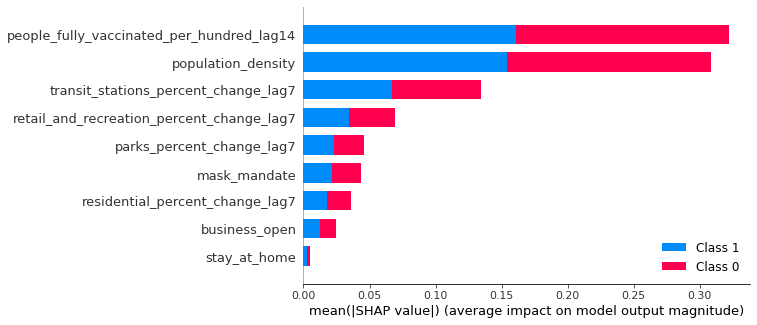

In [309]:
shap.summary_plot(shap_values, X)

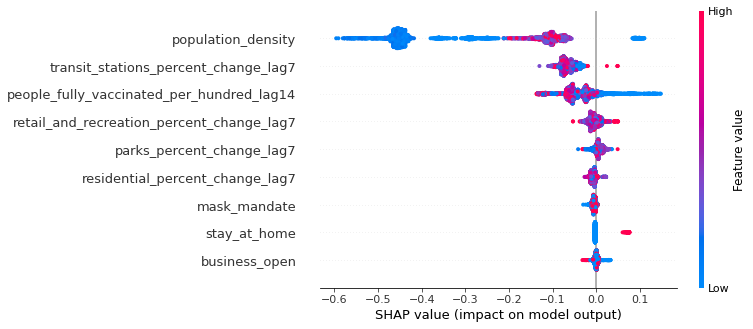

In [328]:
best_model = RandomForestClassifier(bootstrap=False, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=14, max_features='auto',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=1000,
                       n_jobs=None, oob_score=False, random_state=None,
                       verbose=0, warm_start=False)
best_model.fit(X_train, y_train)
explainer = shap.TreeExplainer(best_model)
shap_values = explainer.shap_values(X)
shap.summary_plot(shap_values[1], X)

### SVM

In [310]:
from sklearn.svm import SVC

In [311]:
for k in ["linear", "poly", "rbf", "sigmoid"]:
    clf = make_pipeline(RobustScaler(), SVC(kernel=k, C=1.0, probability=True))
    clf.fit(X_train, y_train)
    print(k, clf.score(X_test, y_test))

linear 0.6371911573472041
poly 0.6397919375812744
rbf 0.7373211963589077
sigmoid 0.5084525357607282


In [329]:
model = SVC(kernel="rbf", C=1.0, probability=True)
scaler = RobustScaler()
X = data_without_na[c]
X_scaled = scaler.fit_transform(X)
X_scaled_df = pd.DataFrame(X_scaled, columns = X.columns)
X_train, X_test, y_train, y_test = train_test_split(X_scaled_df, Y3, test_size=0.2, random_state=42)
model.fit(X_train, y_train)
model.score(X_test, y_test)

0.7373211963589077

In [313]:
explainer = shap.KernelExplainer(model.predict_proba, X_train[:50])
shap_values = explainer.shap_values(X_test[:50], nsamples=100)

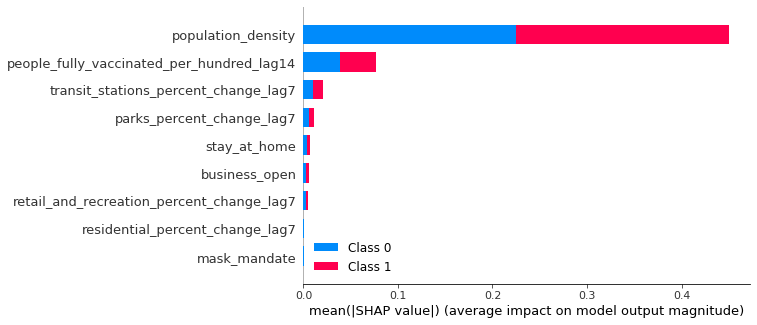

In [314]:
shap.summary_plot(shap_values, X_test[:50])

Using 200 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.


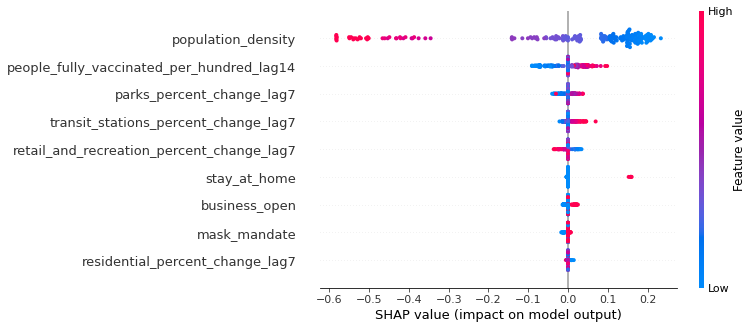

In [331]:
explainer = shap.KernelExplainer(model.predict_proba, X_train[:200])
shap_values = explainer.shap_values(X_test[:200], nsamples=100)
shap.summary_plot(shap_values[1], X_test[:200])

### KNN

In [315]:
from sklearn.neighbors import KNeighborsClassifier

In [316]:
X = data_without_na[c]
X_scaled = scaler.fit_transform(X)
X_scaled_df = pd.DataFrame(X_scaled, columns = X.columns)
X_train, X_test, y_train, y_test = train_test_split(X_scaled_df, Y3, test_size=0.2, random_state=42)

In [317]:
neigh = KNeighborsClassifier()

In [318]:
grid = {"n_neighbors": range(2, 30), "weights": ["uniform", "distance"]}
neigh_random = GridSearchCV(estimator = neigh, param_grid = grid, cv = 3, n_jobs = -2)
neigh_random.fit(X_train, y_train)

GridSearchCV(cv=3, error_score=nan,
             estimator=KNeighborsClassifier(algorithm='auto', leaf_size=30,
                                            metric='minkowski',
                                            metric_params=None, n_jobs=None,
                                            n_neighbors=5, p=2,
                                            weights='uniform'),
             iid='deprecated', n_jobs=-2,
             param_grid={'n_neighbors': range(2, 30),
                         'weights': ['uniform', 'distance']},
             pre_dispatch='2*n_jobs', refit=True, return_train_score=False,
             scoring=None, verbose=0)

In [319]:
neigh_random.best_estimator_

KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='minkowski',
                     metric_params=None, n_jobs=None, n_neighbors=3, p=2,
                     weights='distance')

In [332]:
best_model = neigh_random.best_estimator_
best_model.fit(X_train, y_train)
best_model.score(X_test, y_test)

0.8751625487646294

In [321]:
explainer = shap.KernelExplainer(best_model.predict_proba, X_train[:100])
shap_values = explainer.shap_values(X_test[:100])

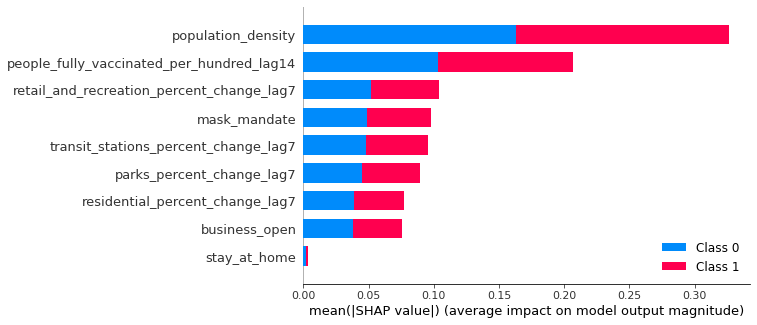

In [322]:
shap.summary_plot(shap_values, X_test[:100])

Using 200 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.


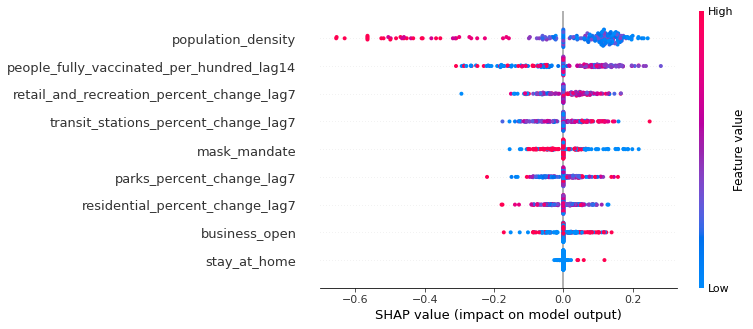

In [333]:
explainer = shap.KernelExplainer(best_model.predict_proba, X_train[:200])
shap_values = explainer.shap_values(X_test[:200], nsamples=100)
shap.summary_plot(shap_values[1], X_test[:200])

## Deep learning model